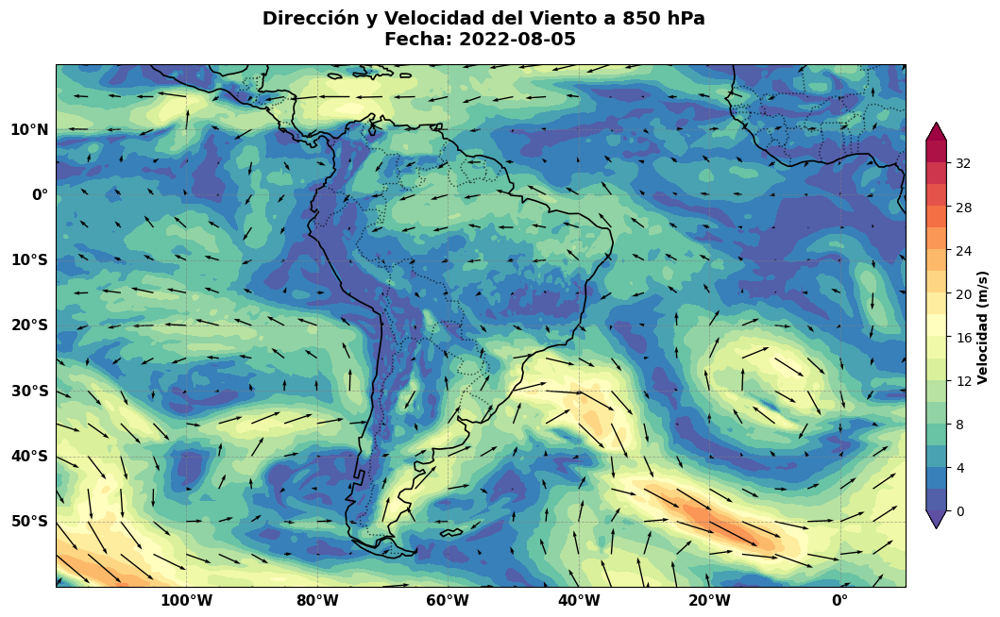

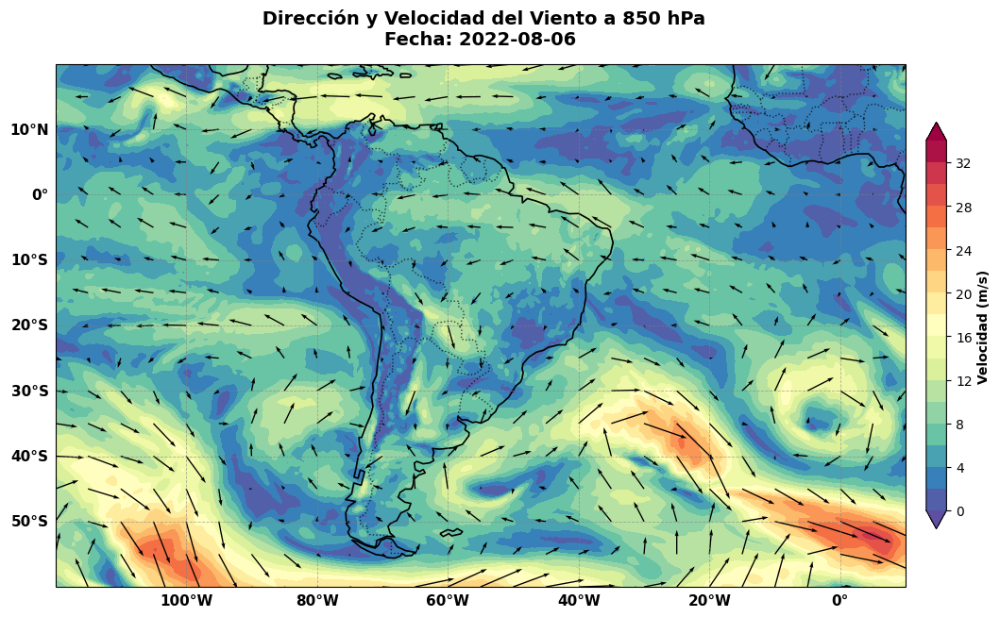

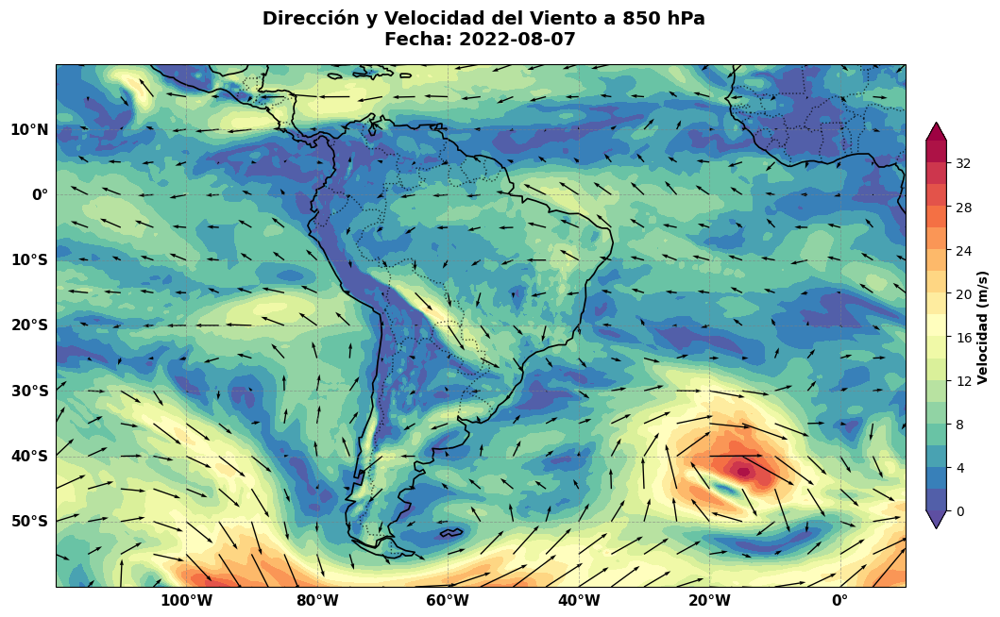

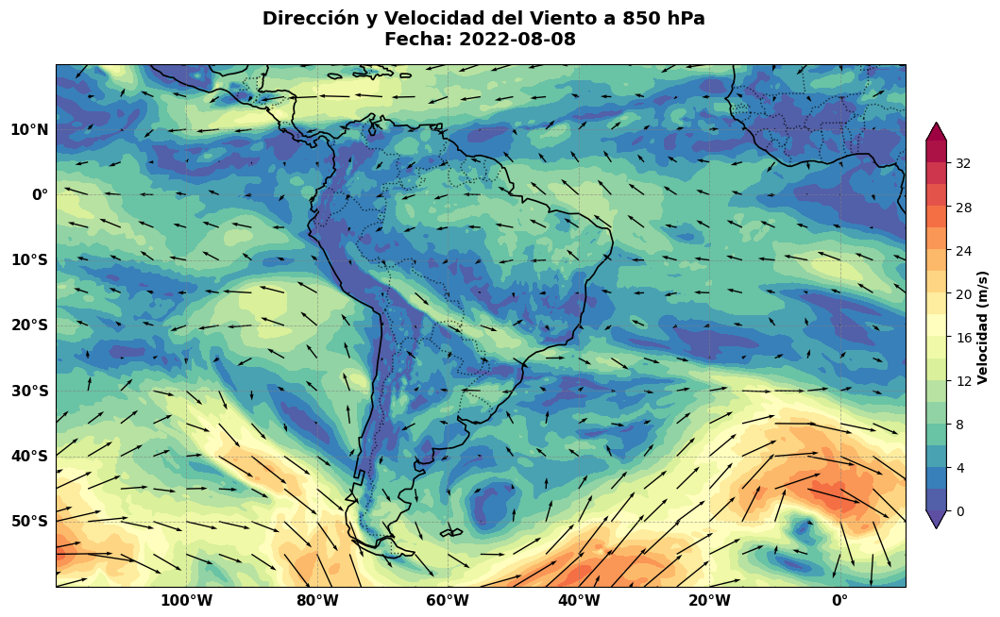

In [20]:
import xarray as xr
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import numpy as np

# 1. Cargar datos ERA5
ds = xr.open_dataset(r"D:\sinop\nc\vientos2022.nc")

# 2. Configuración de nivel y días
nivel = 850
dias = ['2022-08-05', '2022-08-06', '2022-08-07', '2022-08-08']

for fecha in dias:
    # Seleccionamos el día (puedes usar el promedio o una hora fija, ej: 12:00)
    data = ds.sel(valid_time=fecha, pressure_level=nivel).mean(dim='valid_time')
    
    fig = plt.figure(figsize=(14, 8))
    ax = plt.axes(projection=ccrs.PlateCarree())
    
    # LONGITUD AMPLIADA: -120 a 10
    ax.set_extent([-120, 10, -60, 20], crs=ccrs.PlateCarree())
    
    u = data.u.values
    v = data.v.values
    lon, lat = data.longitude.values, data.latitude.values
    speed = np.sqrt(u**2 + v**2)
    
    # 3. GRILLAS (Coordenadas de Latitud y Longitud)
    gl = ax.gridlines(draw_labels=True, linewidth=0.6, color='gray', alpha=0.6, linestyle='--')
    gl.top_labels = False    # Quitar etiquetas de arriba
    gl.right_labels = False  # Quitar etiquetas de la derecha
    gl.xlabel_style = {'size': 11, 'color': 'black', 'weight': 'bold'}
    gl.ylabel_style = {'size': 11, 'color': 'black', 'weight': 'bold'}

    # 4. GRAFICADO DE DATOS
    # Sombreado de fondo (Velocidad)
    im = ax.contourf(lon, lat, speed, levels=np.arange(0, 35, 2),
                     cmap='Spectral_r', extend='both', transform=ccrs.PlateCarree())
    
    # Vectores (Flechas)
    skip = 20
    Q = ax.quiver(lon[::skip], lat[::skip], u[::skip, ::skip], v[::skip, ::skip],
                  color='black', width=0.0015, scale=400, transform=ccrs.PlateCarree())
    
    # Leyenda de la flecha (Escala de 10 m/s)
    ax.quiverkey(Q, 0.9, 0.05, 10, r'$10 \frac{m}{s}$', labelpos='E', coordinates='figure')
    
    # 5. ESTÉTICA
    ax.add_feature(cfeature.COASTLINE, linewidth=1.2)
    ax.add_feature(cfeature.BORDERS, linestyle=':', alpha=0.7)
    ax.add_feature(cfeature.STATES, linewidth=0.3, edgecolor='gray')
    
    # Barra de colores
    cbar = plt.colorbar(im, orientation='vertical', pad=0.02, shrink=0.7)
    cbar.set_label('Velocidad (m/s)', weight='bold')
    
    plt.title(f" Dirección y Velocidad del Viento a {nivel} hPa\nFecha: {fecha}", 
              fontsize=14, fontweight='bold', pad=15)
    
   
    
    plt.show()
    plt.close()

ds.close()

In [19]:
import xarray as xr
import numpy as np
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

# 1. Cargar datos ERA5
ds_v = xr.open_dataset(r"D:\sinop\nc\vientos2022.nc")

# --- TRUCO PARA ELIMINAR LA FRANJA BLANCA ---
# Convertimos las longitudes de 0-360 a -180 a 180 y reordenamos
ds_v = ds_v.assign_coords(longitude=(((ds_v.longitude + 180) % 360) - 180)).sortby('longitude')

# 2. Selección de datos (Nivel 850 hPa)
nivel_v = 850
# Ahora usamos coordenadas estándar (-180 a 180)
data_anim = ds_v.sel(
    valid_time=slice('2022-08-05', '2022-08-08'),
    pressure_level=nivel_v,
    latitude=slice(30, -70),
    longitude=slice(-125, 15) # Selección limpia cruzando el 0
)

fig, ax = plt.subplots(figsize=(12, 8), subplot_kw={'projection': ccrs.PlateCarree()})

# 3. Configuración de Barra de Colores Fija
v_max = 45
sm = plt.cm.ScalarMappable(cmap='Spectral_r', norm=plt.Normalize(vmin=0, vmax=v_max))
cbar = fig.colorbar(sm, ax=ax, orientation='vertical', pad=0.08, shrink=0.6)
cbar.set_label('Velocidad del viento (m/s)', fontsize=10, fontweight='bold')

def actualizar(i):
    ax.clear()
    
    step = data_anim.isel(valid_time=i)
    u = step.u.values
    v = step.v.values
    lons = data_anim.longitude.values
    lats = data_anim.latitude.values
    speed = np.sqrt(u**2 + v**2)
    
    # 4. Extensión del Mapa
    ax.set_extent([-120, 10, -60, 20], crs=ccrs.PlateCarree())
    
    # 5. Grillas y Coordenadas
    gl = ax.gridlines(draw_labels=True, linewidth=0.5, color='gray', alpha=0.5, linestyle='--')
    gl.top_labels = False
    gl.right_labels = False
    gl.xlabel_style = {'size': 10, 'color': 'black', 'weight': 'bold'}
    gl.ylabel_style = {'size': 10, 'color': 'black', 'weight': 'bold'}
    
    # 6. Capas Geográficas
    ax.add_feature(cfeature.COASTLINE, edgecolor='black', linewidth=1)
    ax.add_feature(cfeature.BORDERS, linestyle=':', alpha=0.6)
    
    # 7. Sombreado de Velocidad
    ax.contourf(lons, lats, speed, levels=np.linspace(0, v_max, 15), 
                cmap='Spectral_r', alpha=0.7, transform=ccrs.PlateCarree())
    
    # 8. Vectores (Flechas)
    skip = 13
    ax.quiver(lons[::skip], lats[::skip], u[::skip, ::skip], v[::skip, ::skip],
              color='black', width=0.0012, scale=450, transform=ccrs.PlateCarree())
    
    # Título (Corregido el f-string para que muestre el valor de la variable)
    fecha_h = np.datetime_as_string(step.valid_time.values, unit='h')
    ax.set_title(f"Vectores de viento a {nivel_v} hPa\n{fecha_h} UTC", 
                 fontsize=14, fontweight='bold', pad=20)

ani = FuncAnimation(fig, actualizar, frames=len(data_anim.valid_time), interval=200)
plt.close()

HTML(ani.to_jshtml())

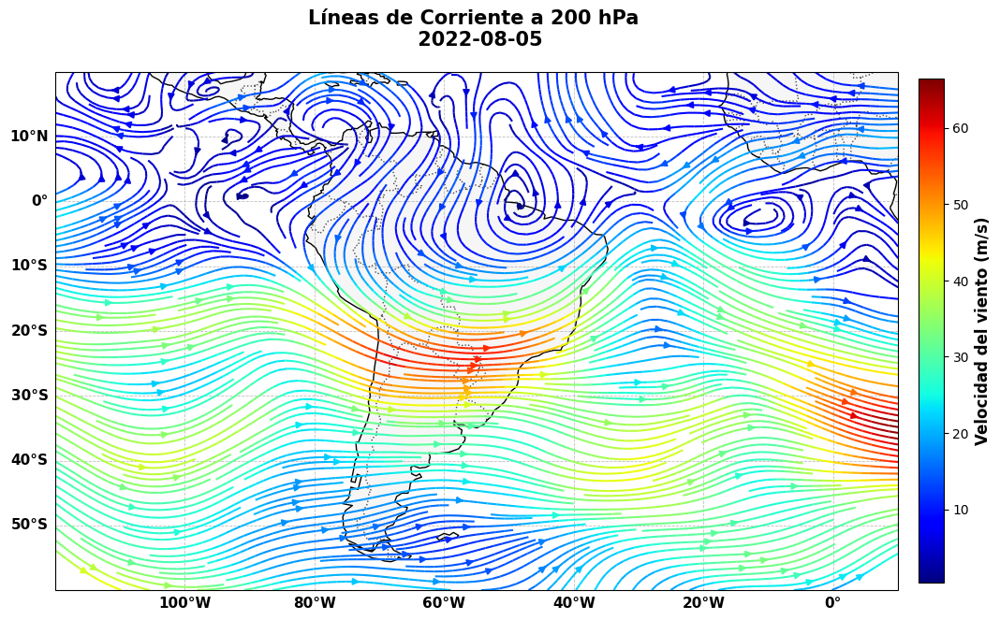

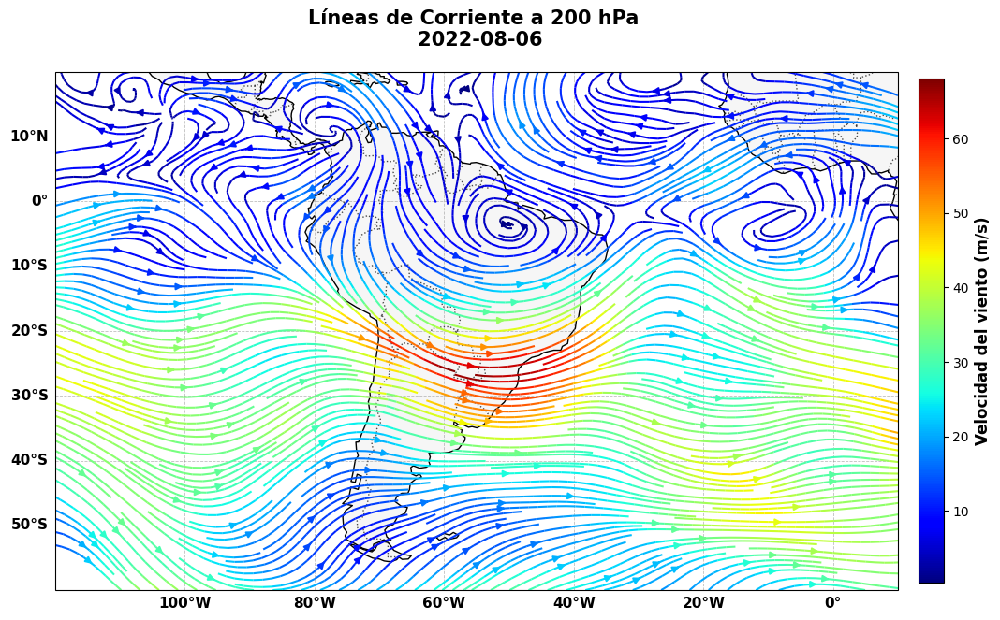

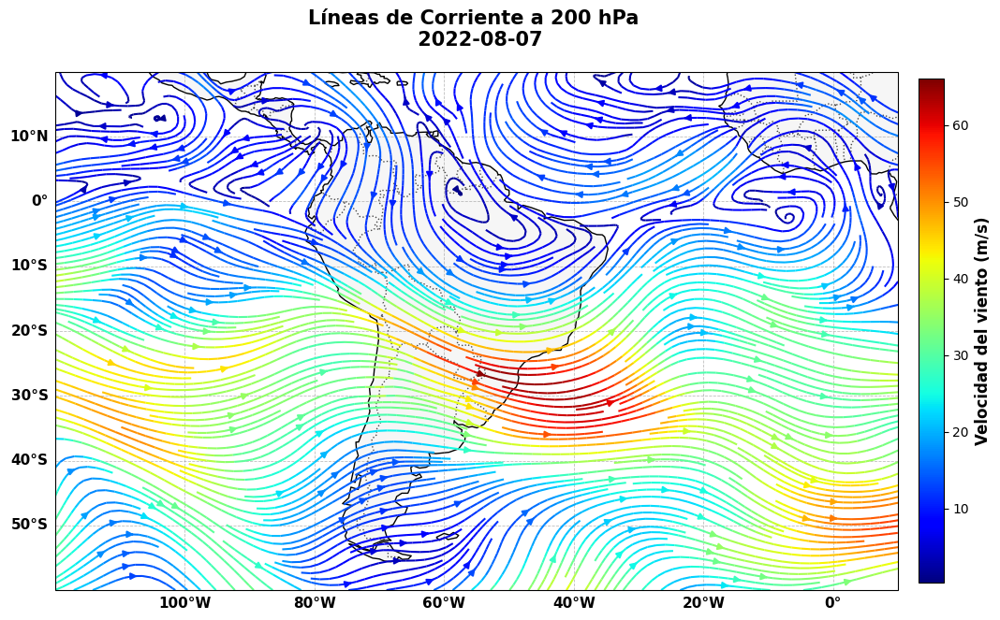

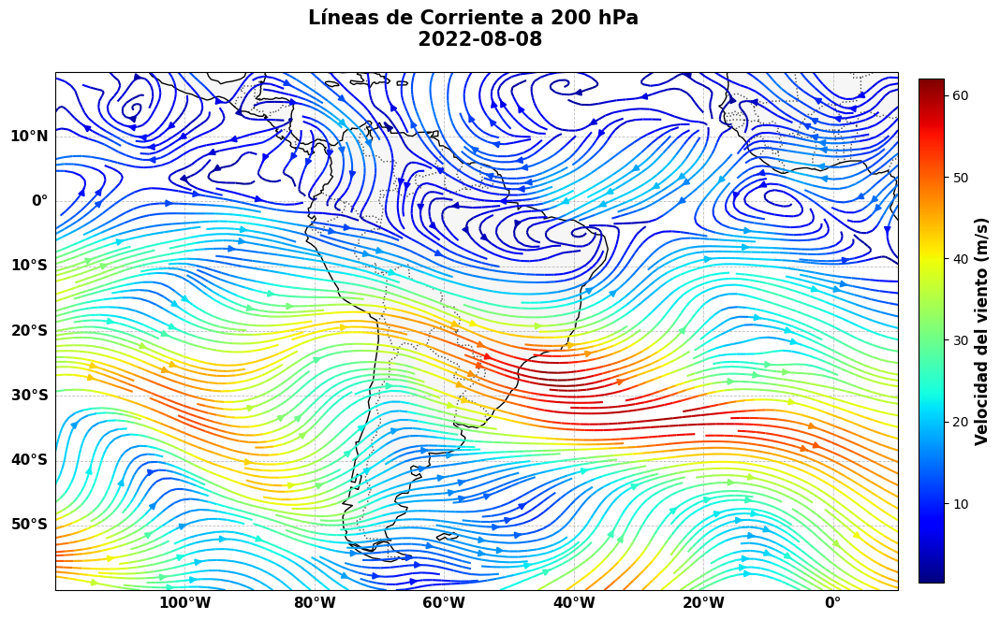

In [4]:
import xarray as xr
import numpy as np
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature

# 1. Cargar y normalizar coordenadas (Elimina franja blanca y ordena lat/lon)
ds = xr.open_dataset(r"D:\sinop\nc\vientos2022.nc")
ds = ds.assign_coords(longitude=(((ds.longitude + 180) % 360) - 180)).sortby(['longitude', 'latitude'])

# 2. Configuración
dias = ['2022-08-05', '2022-08-06', '2022-08-07', '2022-08-08']
nivel = 200  # Nivel de la tropopausa / Jet Stream

for fecha in dias:
    # Seleccionamos el promedio diario para la imagen estática
    data = ds.sel(valid_time=fecha, pressure_level=nivel).mean(dim='valid_time')
    
    fig = plt.figure(figsize=(14, 10))
    ax = plt.axes(projection=ccrs.PlateCarree())
    
    # Extensión ampliada solicitada
    ax.set_extent([-120, 10, -60, 20], crs=ccrs.PlateCarree())
    
    # Variables
    lon, lat = data.longitude.values, data.latitude.values
    u, v = data.u.values, data.v.values
    speed = np.sqrt(u**2 + v**2)
    
    # Grillas con coordenadas marcadas
    gl = ax.gridlines(draw_labels=True, linewidth=0.6, color='gray', alpha=0.5, linestyle='--')
    gl.top_labels = False
    gl.right_labels = False
    gl.xlabel_style = {'size': 11, 'weight': 'bold'}
    gl.ylabel_style = {'size': 11, 'weight': 'bold'}

    # Dibujar líneas de corriente (Streamplot)
    # Nota: Streamplot requiere que lon/lat sean crecientes (ya lo hicimos con sortby)
    strm = ax.streamplot(lon, lat, u, v, color=speed, cmap='jet', 
                         density=3, linewidth=1.5, transform=ccrs.PlateCarree())
    
    # Estética del mapa
    ax.add_feature(cfeature.COASTLINE, linewidth=1)
    ax.add_feature(cfeature.BORDERS, linestyle=':', alpha=0.7)
    ax.add_feature(cfeature.LAND, facecolor='lightgray', alpha=0.2)
    
    # Barra de color
    cbar = plt.colorbar(strm.lines, ax=ax, orientation='vertical', pad=0.02, shrink=0.7)
    cbar.set_label('Velocidad del viento (m/s)', fontsize=12, fontweight='bold')
    
    plt.title(f'Líneas de Corriente a {nivel} hPa \n {fecha}', 
              fontsize=15, fontweight='bold', pad=20)
    
    plt.savefig(f"Streamlines_{nivel}hPa_{fecha}.png", dpi=300, bbox_inches='tight')
    plt.show()

In [5]:
import xarray as xr
import numpy as np
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

# 1. Cargar datos
ds = xr.open_dataset(r"D:\sinop\nc\vientos2022.nc")

# 2. NORMALIZACIÓN CRÍTICA (Para evitar el error de array vacío y franja blanca)
# Convertimos longitudes a -180, 180 y ordenamos latitudes para que slice funcione siempre
ds = ds.assign_coords(longitude=(((ds.longitude + 180) % 360) - 180)).sortby(['longitude', 'latitude'])

# 3. Selección de datos
nivel_v = 200
# Nota: Ahora que ordenamos, usamos slice de menor a mayor en ambos
data_anim = ds.sel(
    valid_time=slice('2022-08-05', '2022-08-08'),
    pressure_level=nivel_v,
    longitude=slice(-125, 15),
    latitude=slice(-65, 25) 
)

# Verificación de seguridad:
if data_anim.longitude.size == 0 or data_anim.latitude.size == 0:
    raise ValueError("¡Error! El recorte espacial está vacío. Revisa las coordenadas del archivo.")

# 4. Configuración de la figura
fig, ax = plt.subplots(figsize=(12, 8), subplot_kw={'projection': ccrs.PlateCarree()})

# Pre-calculamos el máximo de velocidad (usando .compute() para asegurar el valor)
speed_all = np.sqrt(data_anim.u**2 + data_anim.v**2)
v_max = float(speed_all.max().compute())

sm = plt.cm.ScalarMappable(cmap='jet', norm=plt.Normalize(vmin=0, vmax=v_max))
cbar = fig.colorbar(sm, ax=ax, orientation='vertical', pad=0.05, shrink=0.6)
cbar.set_label('Velocidad (m/s)', fontweight='bold')

def actualizar(i):
    ax.clear()
    
    step = data_anim.isel(valid_time=i)
    lon, lat = step.longitude.values, step.latitude.values
    u, v = step.u.values, step.v.values
    speed = np.sqrt(u**2 + v**2)
    
    # Mapa y grillas
    ax.set_extent([-120, 10, -60, 20], crs=ccrs.PlateCarree())
    ax.add_feature(cfeature.COASTLINE, linewidth=1)
    ax.add_feature(cfeature.BORDERS, linestyle=':')
    
    gl = ax.gridlines(draw_labels=True, linewidth=0.5, color='gray', alpha=0.4, linestyle='--')
    gl.top_labels = gl.right_labels = False
    gl.xlabel_style = {'size': 10, 'weight': 'bold'}
    gl.ylabel_style = {'size': 10, 'weight': 'bold'}
    
    # Streamplot (Líneas de corriente)
    # A 200 hPa el Jet Stream se ve mejor con densidad alta
    skip = 2
    strm = ax.streamplot(lon[::skip], lat[::skip], u[::skip, ::skip], v[::skip, ::skip],
                         color=speed[::skip, ::skip], cmap='jet', 
                         density=2.5, linewidth=1.2, transform=ccrs.PlateCarree())
    
    fecha_h = np.datetime_as_string(step.valid_time.values, unit='h')
    ax.set_title(f"Líneas de Corriente a {nivel_v} hPa\n{fecha_h} UTC", 
                 fontsize=14, fontweight='bold')

# Crear animación
ani = FuncAnimation(fig, actualizar, frames=len(data_anim.valid_time), interval=200)
plt.close()

HTML(ani.to_jshtml())